<a href="https://colab.research.google.com/github/shumshersubashgautam/Cellpainting-Visualization-RXRX1-Recursion/blob/main/DataVisualization-RXRX-RecursionData.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [30]:
# !pip install scanpy==1.9.3 anndata==0.9.1 umap numpy==1.22.4 scipy==1.10.1 pandas==1.5.3 scikit-learn==1.2.2 statsmodels==0.13.5 python-igraph==0.10.4 pynndescent==0.5.10 squidpy==1.1.2

In [ ]:
# !pip install tangram-sc

In [5]:
cd cell

/content/cell


In [ ]:
# !python setup.py install

In [8]:
# !pip install scArches

In [12]:
import scanpy as sc
import pandas as pd
import sys
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from bcc.utils import plot_well_type_positions
%matplotlib inline

In [11]:
# !pip install mvtcr
# !pip install multigrate

In [13]:
!git clone https://github.com/recursionpharma/rxrx1-utils
sys.path.append('rxrx1-utils')
import rxrx.io as rio #Using the method from Recursion (https://github.com/recursionpharma/rxrx1-utils/tree/trunk/notebooks),

Cloning into 'rxrx1-utils'...
remote: Enumerating objects: 127, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 127 (delta 0), reused 0 (delta 0), pack-reused 124
Receiving objects: 100% (127/127), 1.59 MiB | 25.42 MiB/s, done.
Resolving deltas: 100% (62/62), done.


In [14]:
CHANNELS = [1,2,3,4,5,6]
def visualize(data, experiment, plate, well, site, channels=CHANNELS, ax=None):
    img_tensor = rio.load_site(data, experiment, plate, well, site)
    img = rio.convert_tensor_to_rgb(img_tensor)

    if ax is None:
        fig = plt.figure()
        ax = fig.add_subplot(111)
    ax.imshow(img)
    ax.set_axis_off()
    return img

def visualize_cells_with_sirna(dataset, experiment,  well, site, sirna, plate=0, channels=CHANNELS):
    well_size = 10
    title_fs = 25

    fig = plt.figure(figsize=(5*well_size, 3*well_size))
    experiment = experiment
    sirna = sirna
    well = well
    site = site

    if plate == 0:
        for plate in range(1, 5):
            ax = fig.add_subplot(2, 4, plate)
            visualize(dataset, experiment, plate, well, site=site, channels=channels, ax=ax)
            ax.set_title(f'{experiment} Plate{plate}, siRNA {sirna} , well {well}, site {site}', fontdict={'fontsize': title_fs})

    else:
        plate = plate
        y = rio.load_site_as_rgb(dataset, experiment, plate, well, site)
        plt.figure(figsize=(3,3))
        plt.axis('off')
        plt.title(f'{experiment} Plate{plate}, siRNA {sirna} , well {well}, site {site}', fontdict={'fontsize': 7})
        _ = plt.imshow(y)

In [17]:
!wget https://storage.googleapis.com/rxrx/rxrx1/rxrx1-metadata.zip

--2023-06-24 08:57:09--  https://storage.googleapis.com/rxrx/rxrx1/rxrx1-metadata.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.163.128, 142.251.167.128, 142.251.16.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.163.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1333687 (1.3M) [application/zip]
Saving to: ‘rxrx1-metadata.zip’

rxrx1-metadata.zip  100%[===================>]   1.27M  --.-KB/s    in 0.01s   

2023-06-24 08:57:10 (122 MB/s) - ‘rxrx1-metadata.zip’ saved [1333687/1333687]



In [18]:
!unzip /content/cell/rxrx1-metadata.zip

Archive:  /content/cell/rxrx1-metadata.zip
   creating: rxrx1/
  inflating: rxrx1/LICENSE           
  inflating: rxrx1/README.md         
  inflating: rxrx1/metadata.csv      


In [19]:
!wget https://storage.googleapis.com/rxrx/rxrx1/rxrx1-dl-embeddings.zip

--2023-06-24 08:58:01--  https://storage.googleapis.com/rxrx/rxrx1/rxrx1-dl-embeddings.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 172.253.63.128, 142.250.31.128, 142.251.111.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|172.253.63.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 51946666 (50M) [application/zip]
Saving to: ‘rxrx1-dl-embeddings.zip’

rxrx1-dl-embeddings 100%[===================>]  49.54M   154MB/s    in 0.3s    

2023-06-24 08:58:01 (154 MB/s) - ‘rxrx1-dl-embeddings.zip’ saved [51946666/51946666]



In [20]:
!unzip /content/cell/rxrx1-dl-embeddings.zip

Archive:  /content/cell/rxrx1-dl-embeddings.zip
replace rxrx1/LICENSE? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: rxrx1/LICENSE           
replace rxrx1/README.md? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: rxrx1/README.md         
  inflating: rxrx1/embeddings.csv    


In [21]:
meta_file = "/content/cell/rxrx1/metadata.csv"
data_file = "/content/cell/rxrx1/embeddings.csv"
if not os.path.exists(meta_file):
    raise FileNotFoundError("Please download the metadata from https://www.rxrx.ai/rxrx1 and put the file metadata.csv in the directory data/rxrx1")
if not os.path.exists(meta_file):
    raise FileNotFoundError("Please download the embeddings from https://www.rxrx.ai/rxrx1 and put the file embeddings.csv in the directory data/rxrx1")
metadata_df = pd.read_csv(meta_file)
embeddings_df = pd.read_csv(data_file)

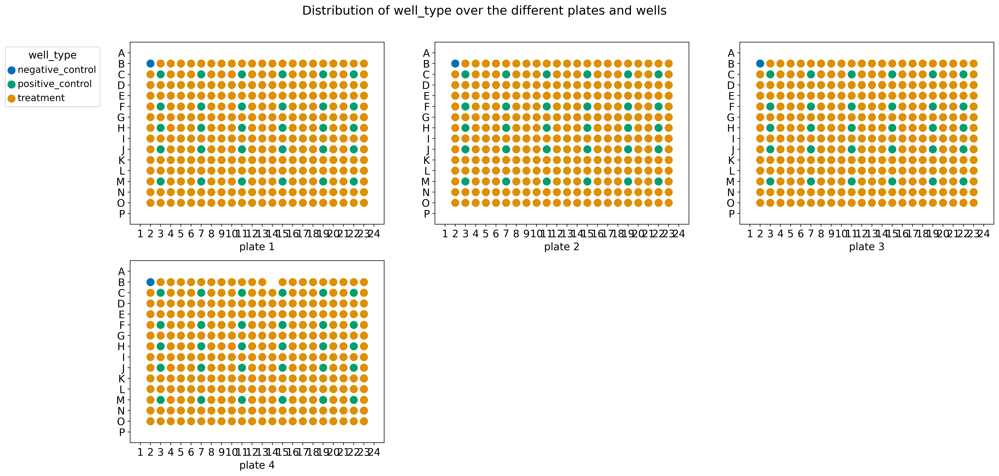

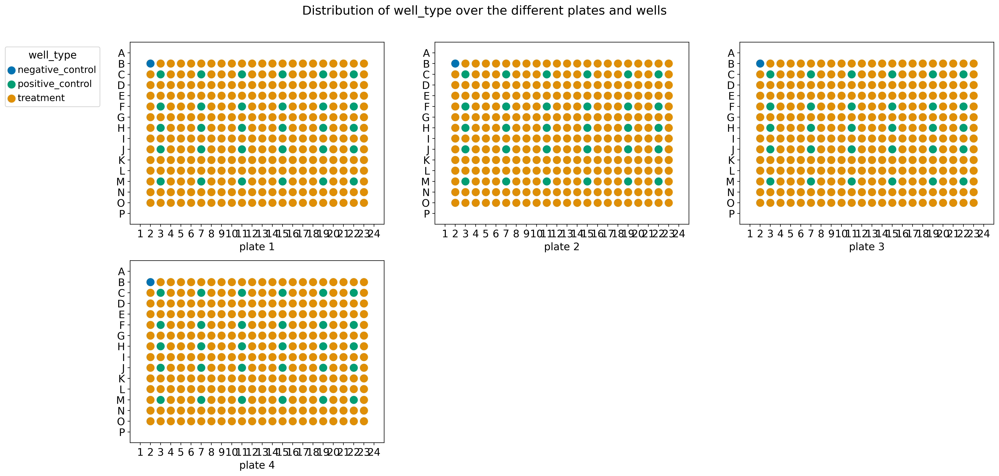

In [22]:
f = plot_well_type_positions(metadata_df[metadata_df.experiment=="HEPG2-08"], "well", "well_type", "plate", 16, 24)
f = plot_well_type_positions(metadata_df[metadata_df.experiment=="U2OS-01"], "well", "well_type", "plate", 16, 24)

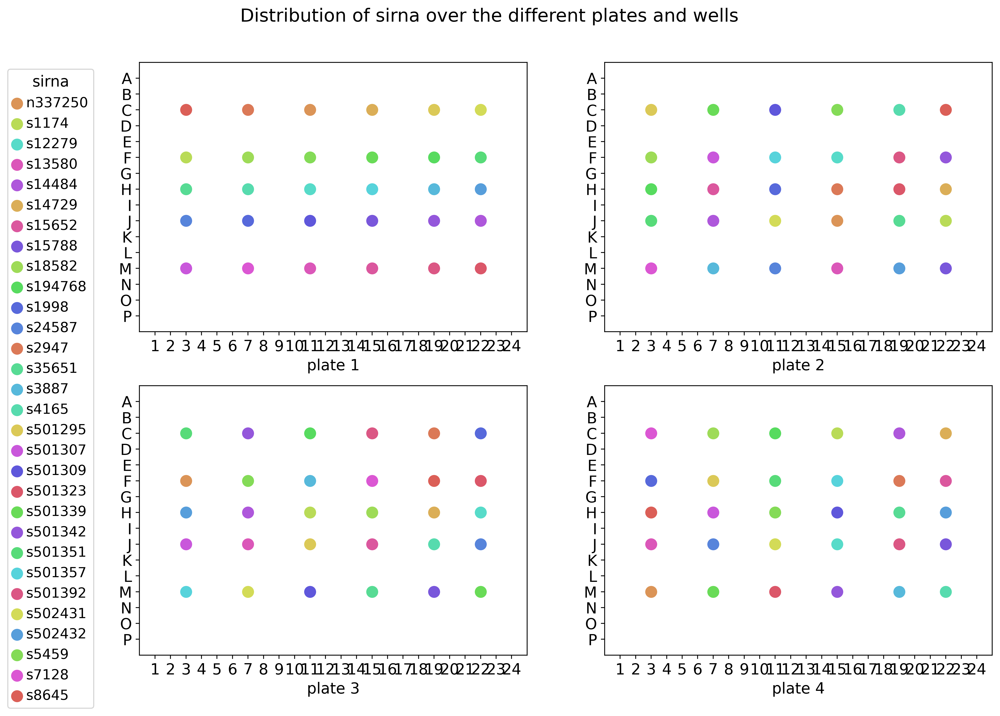

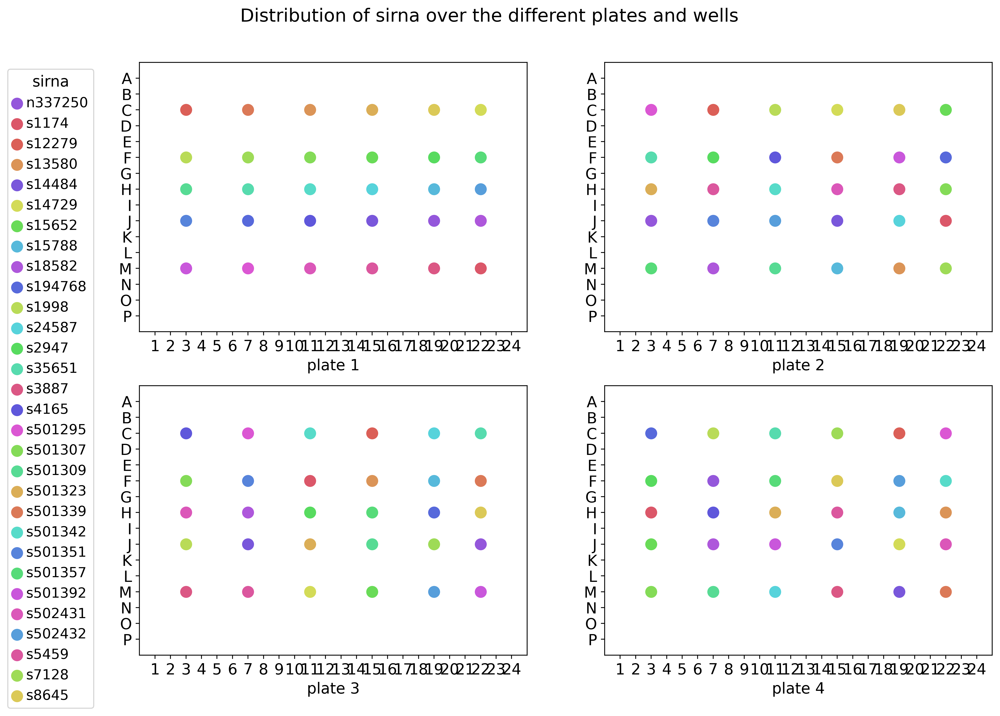

In [23]:
f = plot_well_type_positions(metadata_df[(metadata_df.experiment=="HEPG2-08") & (metadata_df.well_type=="positive_control")], "well", "sirna", "plate", 16, 24, 2)
f = plot_well_type_positions(metadata_df[(metadata_df.experiment=="U2OS-01") & (metadata_df.well_type=="positive_control")], "well", "sirna", "plate", 16, 24,2)

<Figure size 10000x6000 with 0 Axes>

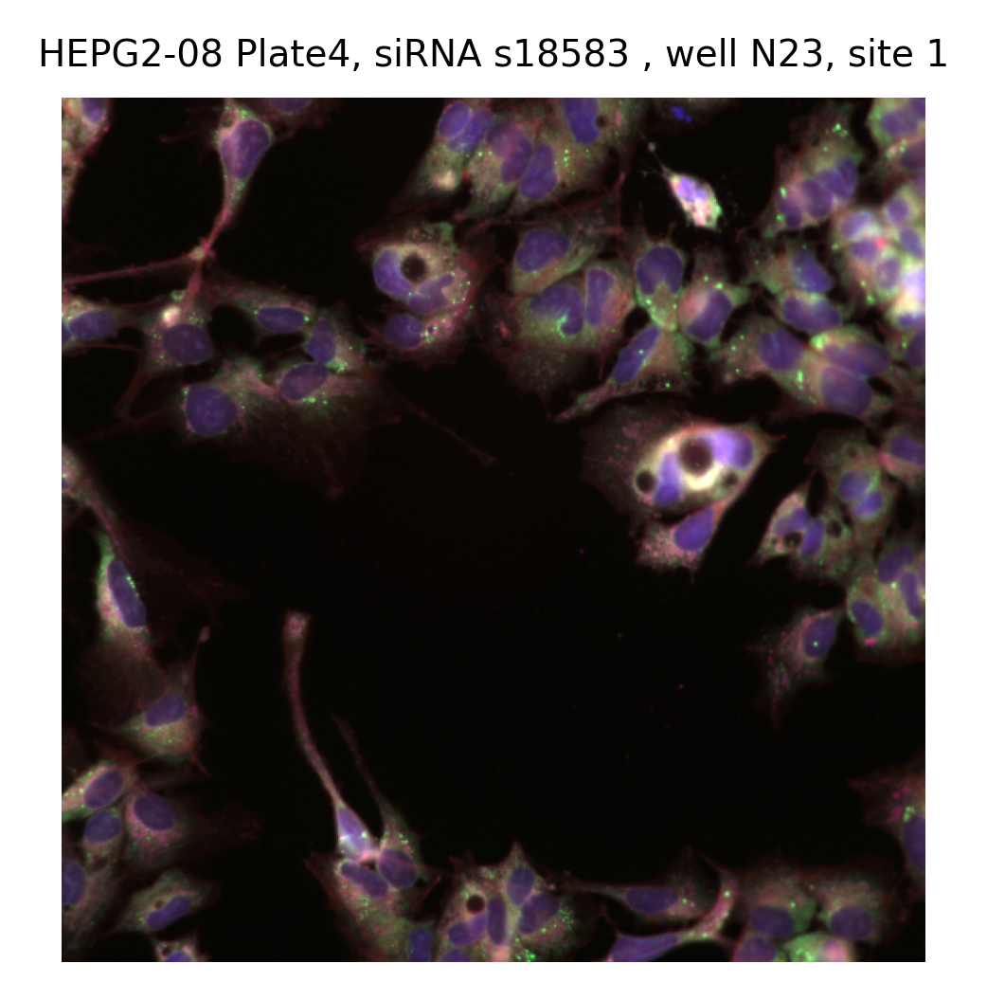

In [24]:
#Celltype HEPG2: site 1
visualize_cells_with_sirna(dataset = 'test', experiment = 'HEPG2-08', well = 'B02', site = 1, sirna = 'EMPTY') # negative control
visualize_cells_with_sirna(dataset = 'test', experiment = 'HEPG2-08', well = 'F07', site = 1, sirna= 's18582') # positive control
visualize_cells_with_sirna(dataset = 'test', experiment = 'HEPG2-08', plate = 4, well = 'N23', site = 1, sirna= 's18583') #treatment

<Figure size 10000x6000 with 0 Axes>

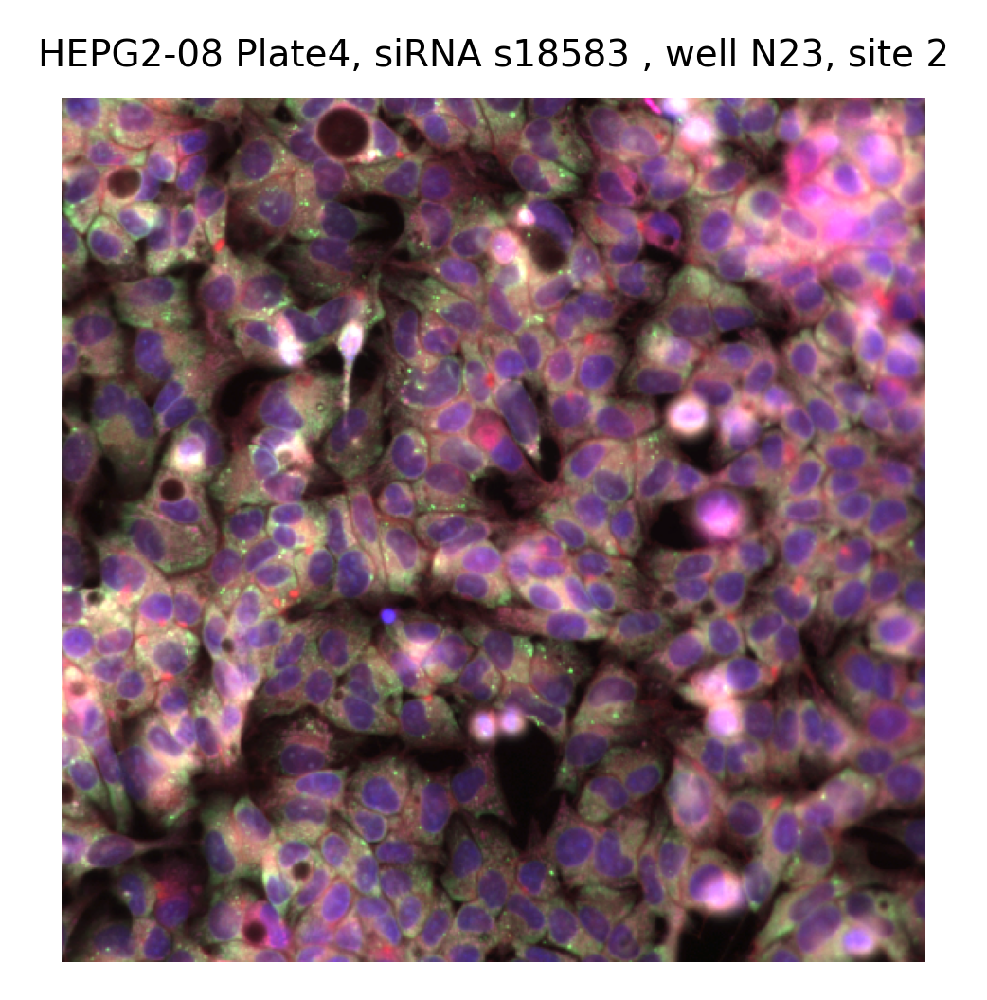

In [25]:
#Celltype HEPG2: site 2
visualize_cells_with_sirna(dataset = 'test', experiment = 'HEPG2-08', well = 'B02', site = 2, sirna = 'EMPTY') # same negative control location in all plates across all experiments
visualize_cells_with_sirna(dataset = 'test', experiment = 'HEPG2-08', well = 'F07', site = 2, sirna= 's18582') # one of the 30 wells with positive control
visualize_cells_with_sirna(dataset = 'test', experiment = 'HEPG2-08', plate = 4, well = 'N23', site = 2, sirna= 's18583') # random other well with treatment

In [26]:
meta_file = "/content/cell/rxrx1/metadata.csv"
data_file = "/content/cell/rxrx1/embeddings.csv"
adata = sc.read_csv(data_file)
meta = pd.read_csv(meta_file, index_col = 0)
# change the order of the rows in the meta data to match the order in the embeddings
meta = meta.reindex(pd.read_csv(data_file, index_col = 0).index)
adata.obs = meta
adata.obs['well_row'], adata.obs['well_column'] = adata.obs['well'].str[:1], adata.obs['well'].str[1:]
print(adata)
meta.head(n=3)

AnnData object with n_obs × n_vars = 125510 × 128
    obs: 'well_id', 'cell_type', 'dataset', 'experiment', 'plate', 'well', 'site', 'well_type', 'sirna', 'sirna_id', 'well_row', 'well_column'


,well_id,cell_type,dataset,experiment,plate,well,site,well_type,sirna,sirna_id,well_row,well_column
site_id,,,,,,,,,,,,
U2OS-01_1_B02_1,U2OS-01_1_B02,U2OS,train,U2OS-01,1,B02,1,negative_control,EMPTY,1138,B,02
U2OS-01_1_B02_2,U2OS-01_1_B02,U2OS,train,U2OS-01,1,B02,2,negative_control,EMPTY,1138,B,02
U2OS-01_1_B03_1,U2OS-01_1_B03,U2OS,train,U2OS-01,1,B03,1,treatment,s19651,267,B,03


In [27]:
sc.pp.neighbors(adata, n_neighbors=15, use_rep = "X")
sc.tl.umap(adata)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


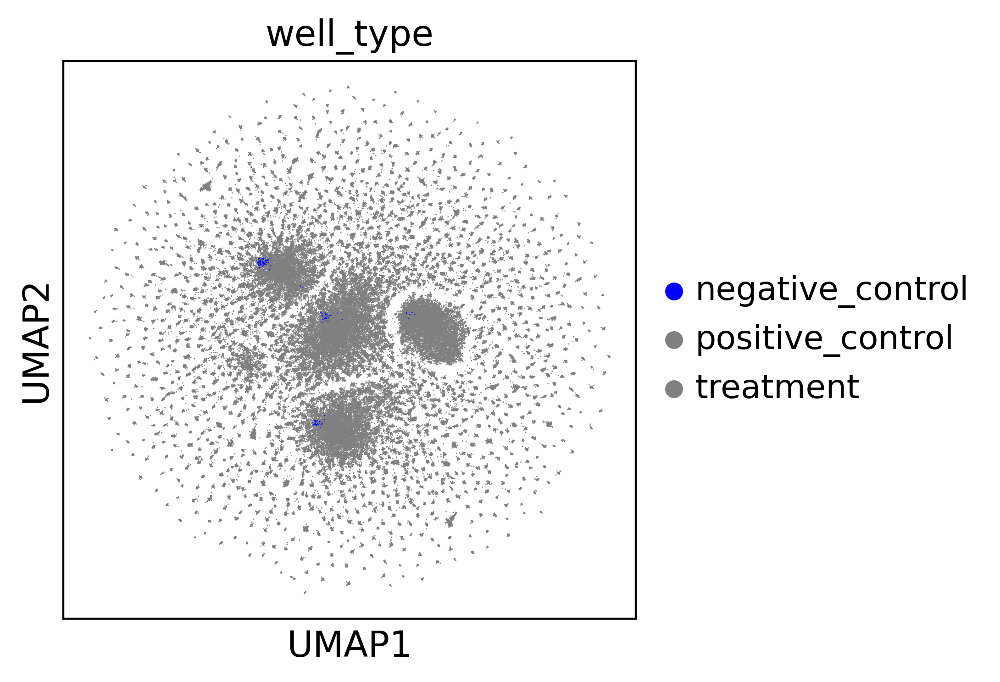

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


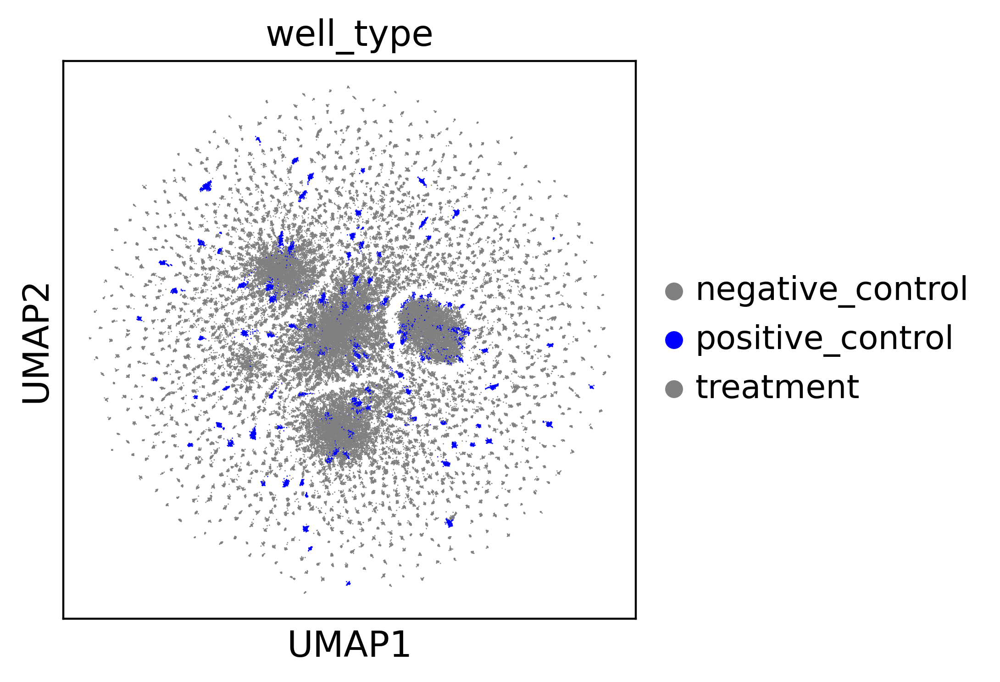

In [28]:
sc.pl.umap(adata, color="well_type", palette={"positive_control": "grey", "treatment": "grey", "negative_control": "blue"})
sc.pl.umap(adata, color="well_type", palette={"negative_control": "grey", "treatment": "grey", "positive_control": "blue"})

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


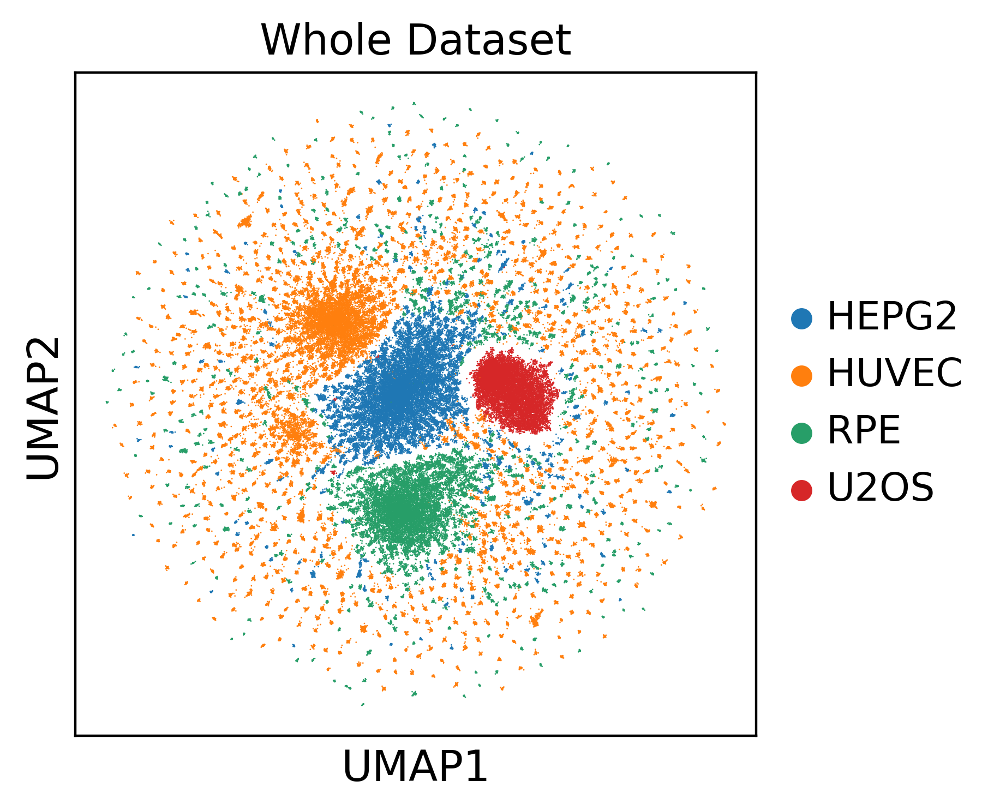

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


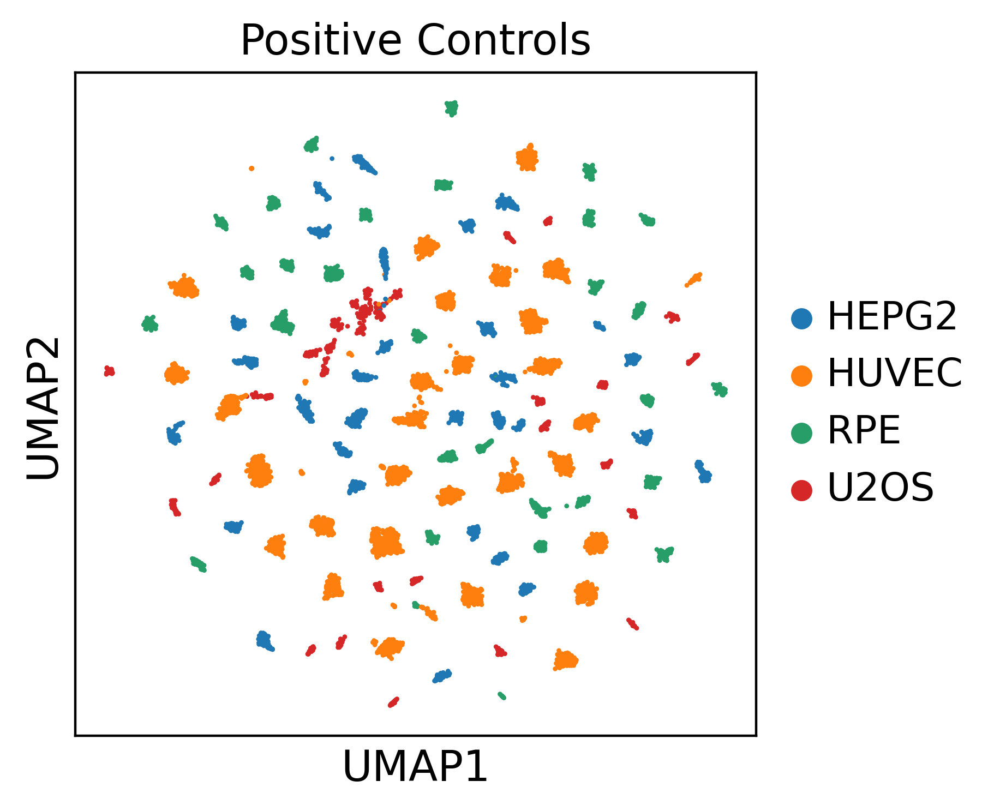

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


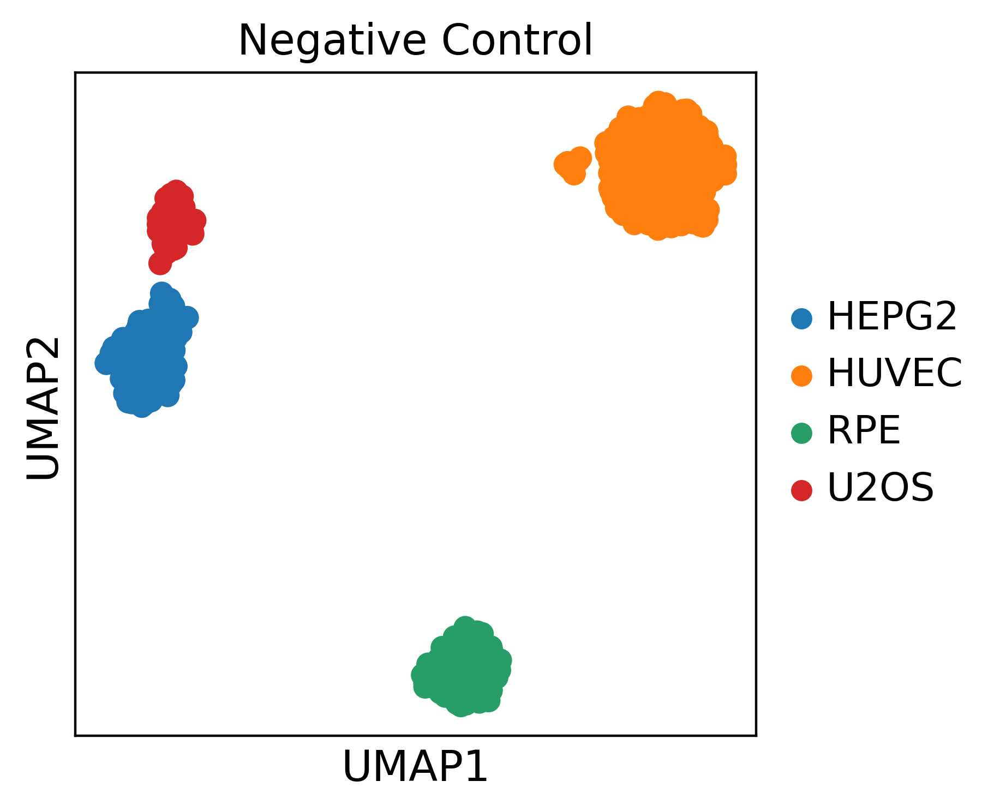

In [29]:
#Whole dataset:
sc.pl.umap(adata, color="cell_type", title = "Whole Dataset")
#positive controls:
poscontrols = adata[adata.obs["well_type"] == "positive_control"]
sc.pp.neighbors(poscontrols, n_neighbors=15, use_rep = "X")
sc.tl.umap(poscontrols)
sc.pl.umap(poscontrols, color=["cell_type"], title = "Positive Controls")
#negative controls:
negcontrols = adata[adata.obs["well_type"] == "negative_control"]
sc.pp.neighbors(negcontrols, n_neighbors=15, use_rep = "X")
sc.tl.umap(negcontrols)
sc.pl.umap(negcontrols, color=["cell_type"], title = "Negative Control")

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


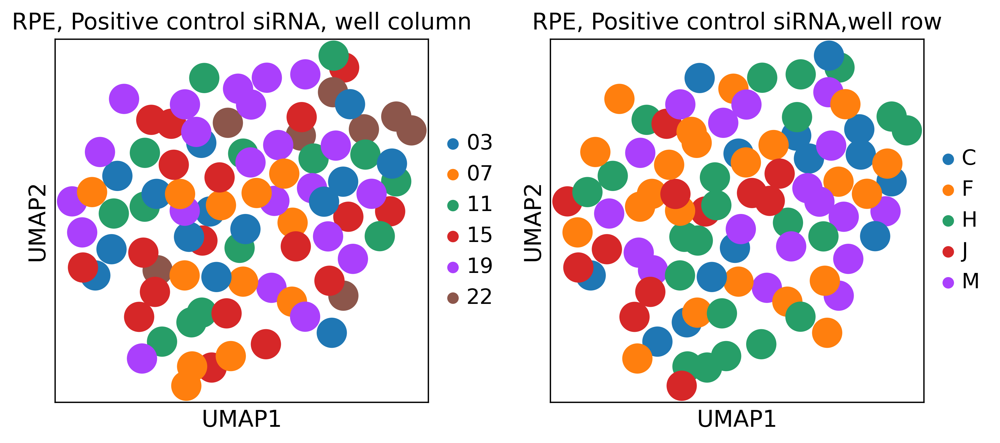

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


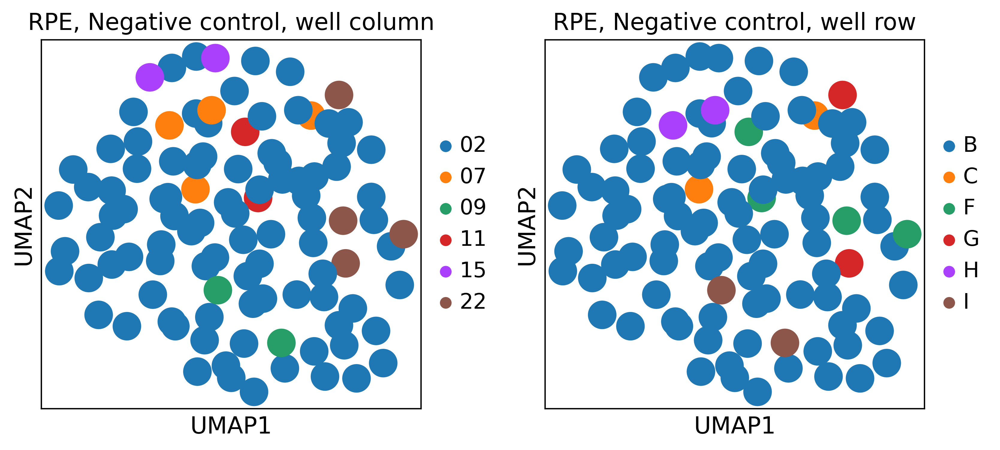

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


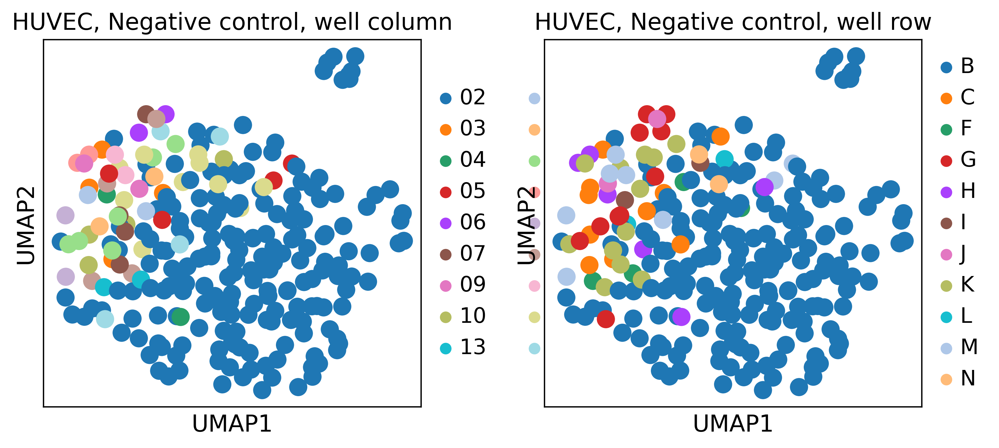

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


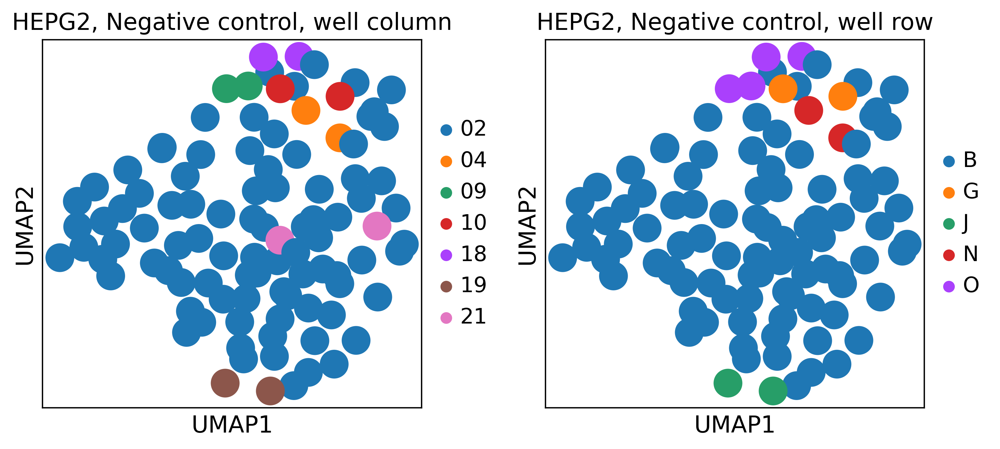

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


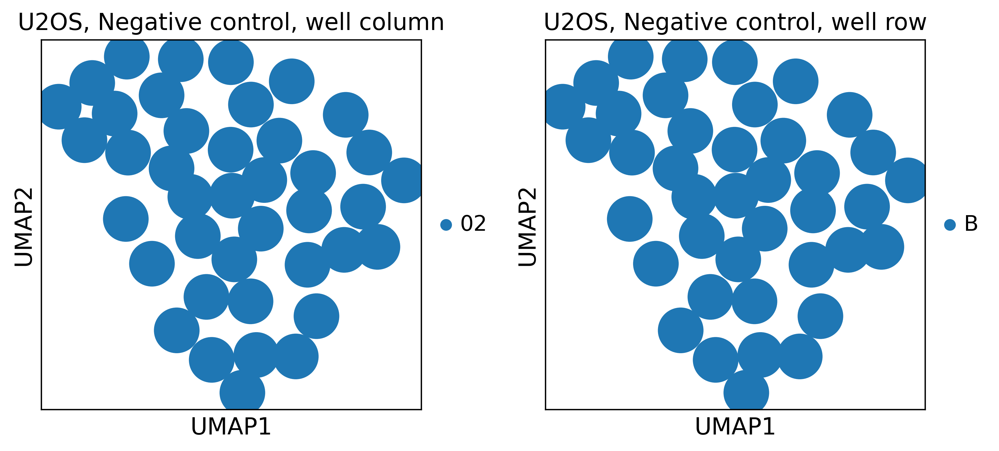

In [31]:
#positive control siRNA:
poscontrol_sirna = adata[(adata.obs["sirna"] == "s12279")  & (adata.obs["cell_type"] == "RPE")]
sc.pp.neighbors(poscontrol_sirna, n_neighbors=15, use_rep = "X")
sc.tl.umap(poscontrol_sirna)
sc.pl.umap(poscontrol_sirna, color=["well_column", "well_row"], title = ["RPE, Positive control siRNA, well column", "RPE, Positive control siRNA,well row"])
#negative control:
#RPE
negcontrol_rpe= adata[(adata.obs["sirna"] == "EMPTY")  & (adata.obs["cell_type"] == "RPE")]
sc.pp.neighbors(negcontrol_rpe, n_neighbors=15, use_rep = "X")
sc.tl.umap(negcontrol_rpe)
sc.pl.umap(negcontrol_rpe, color=["well_column", "well_row"], title = ["RPE, Negative control, well column", "RPE, Negative control, well row"])
#HUVEC
negcontrol_huvec = adata[(adata.obs["sirna"] == "EMPTY")  & (adata.obs["cell_type"] == "HUVEC")]
sc.pp.neighbors(negcontrol_huvec, n_neighbors=15, use_rep = "X")
sc.tl.umap(negcontrol_huvec)
sc.pl.umap(negcontrol_huvec, color=["well_column", "well_row"], title = ["HUVEC, Negative control, well column","HUVEC, Negative control, well row" ])
#HEPG2
negcontrol_hepg2 = adata[(adata.obs["sirna"] == "EMPTY")  & (adata.obs["cell_type"] == "HEPG2")]
sc.pp.neighbors(negcontrol_hepg2, n_neighbors=15, use_rep = "X")
sc.tl.umap(negcontrol_hepg2)
sc.pl.umap(negcontrol_hepg2, color=["well_column", "well_row"], title = ["HEPG2, Negative control, well column","HEPG2, Negative control, well row"])
#U2OS
negcontrol_u2os = adata[(adata.obs["sirna"] == "EMPTY")  & (adata.obs["cell_type"] == "U2OS")]
sc.pp.neighbors(negcontrol_u2os, n_neighbors=15, use_rep = "X")
sc.tl.umap(negcontrol_u2os)
sc.pl.umap(negcontrol_u2os, color=["well_column", "well_row"], title = ["U2OS, Negative control, well column", "U2OS, Negative control, well row"])

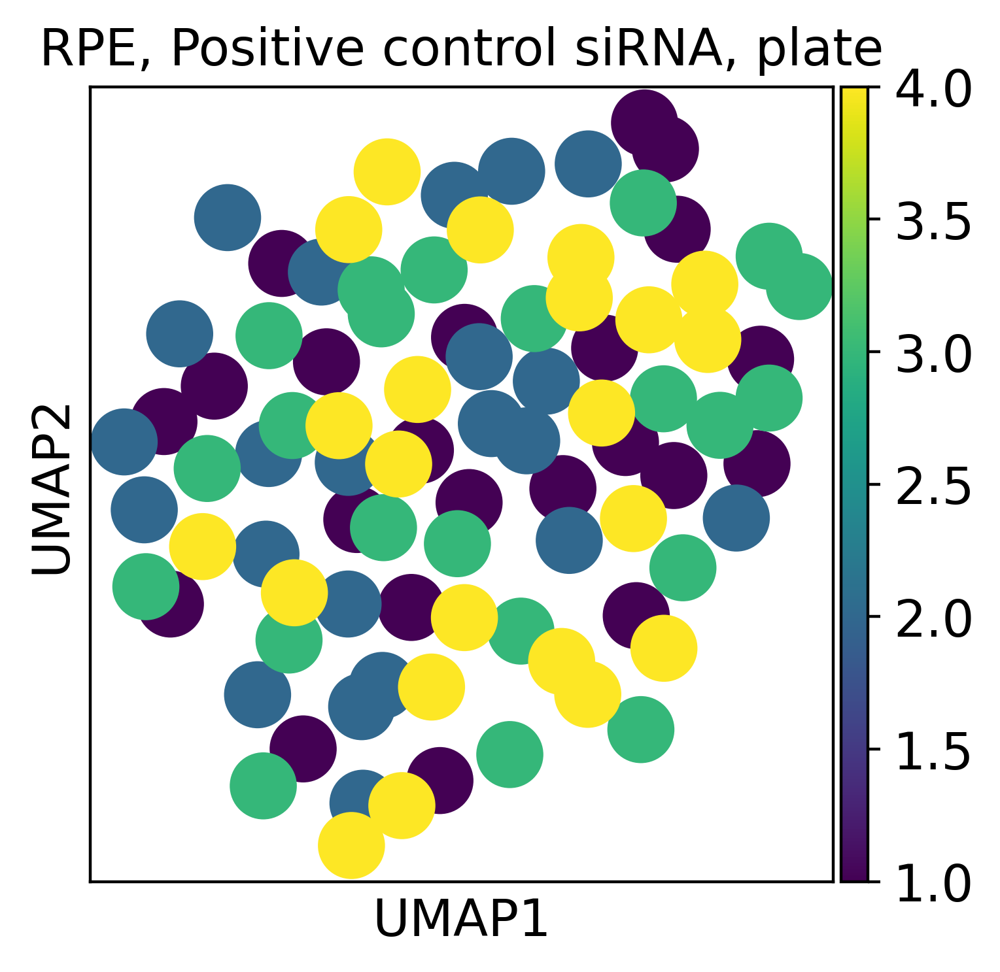

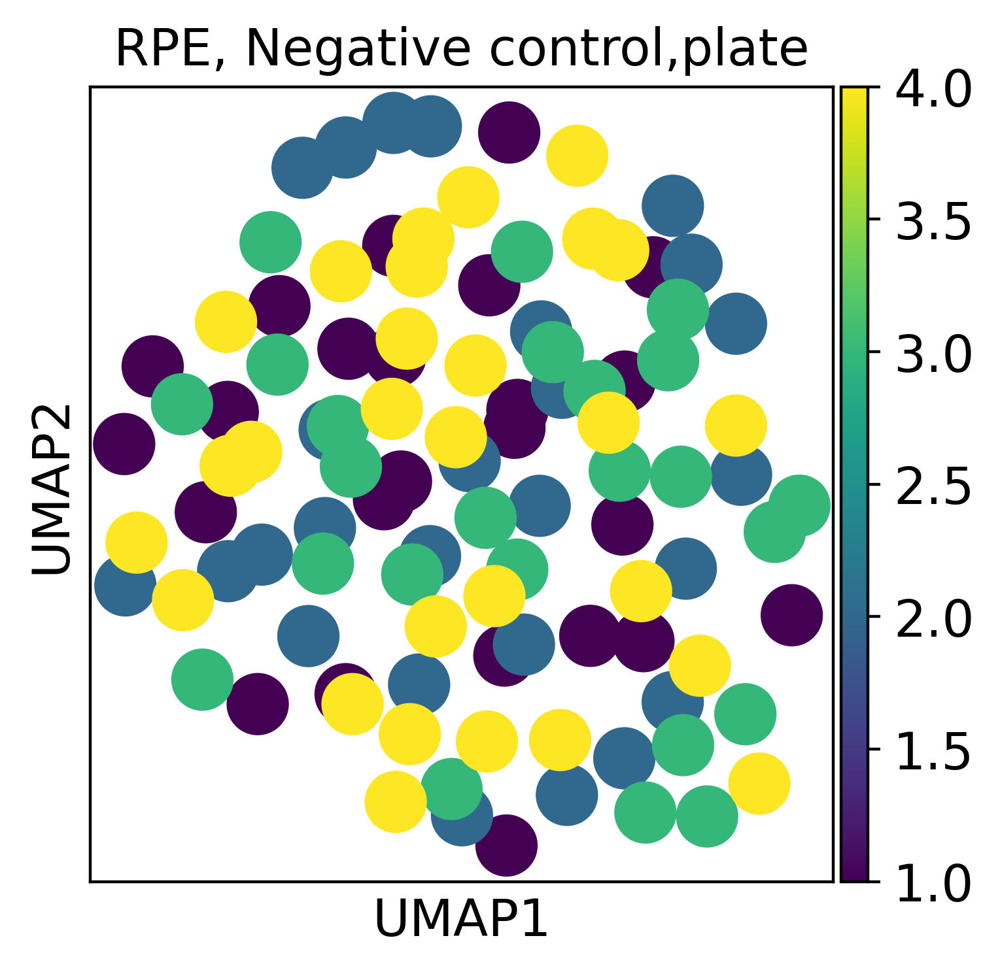

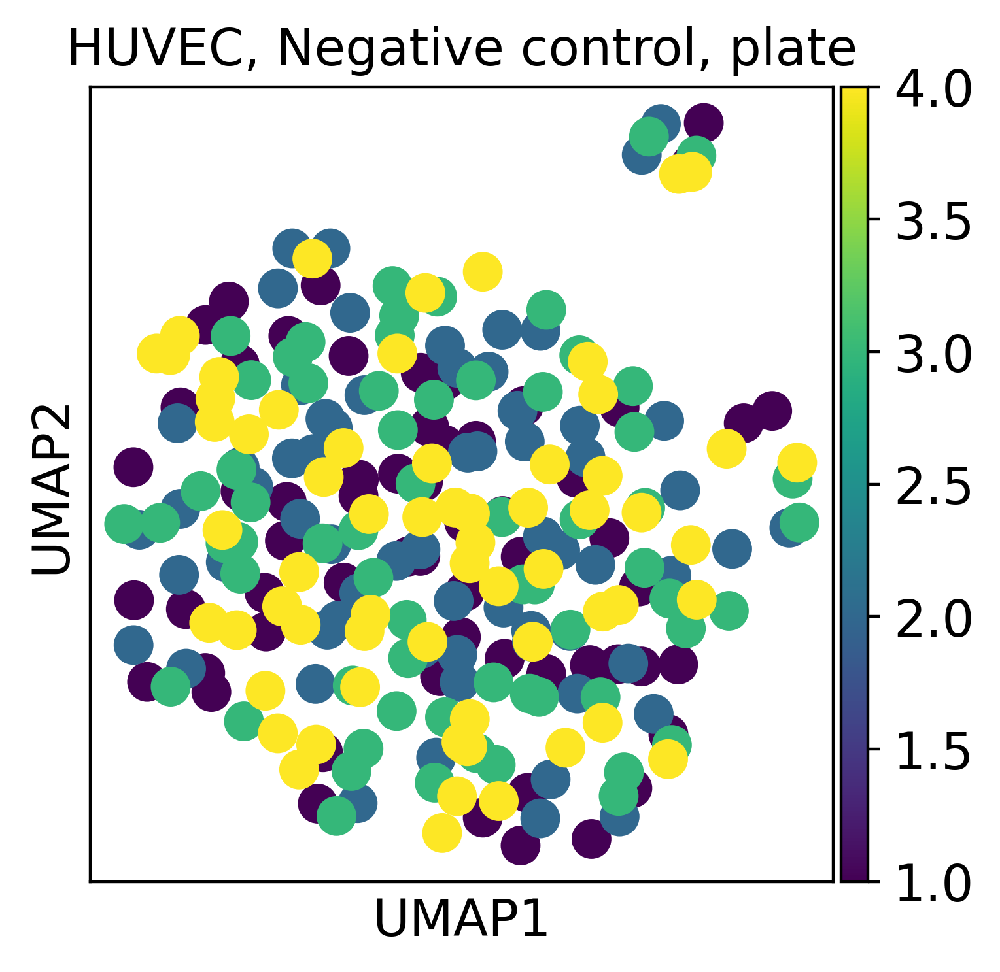

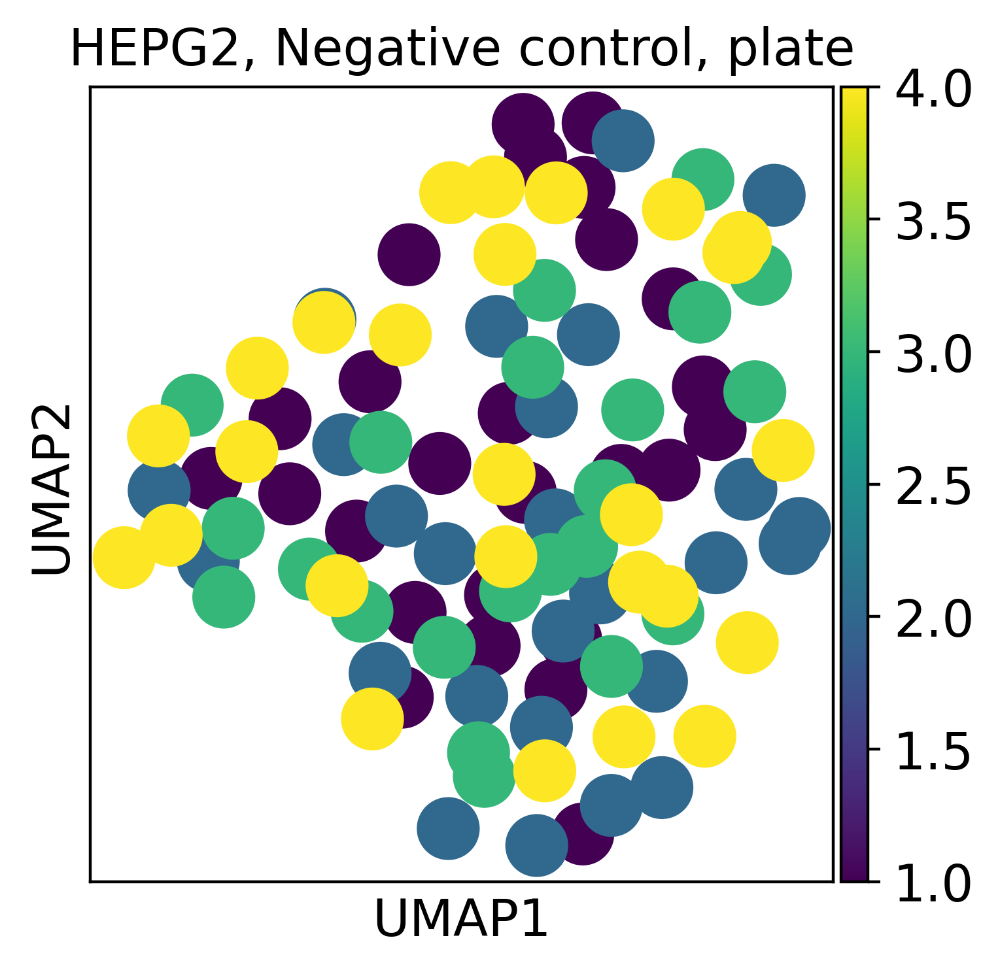

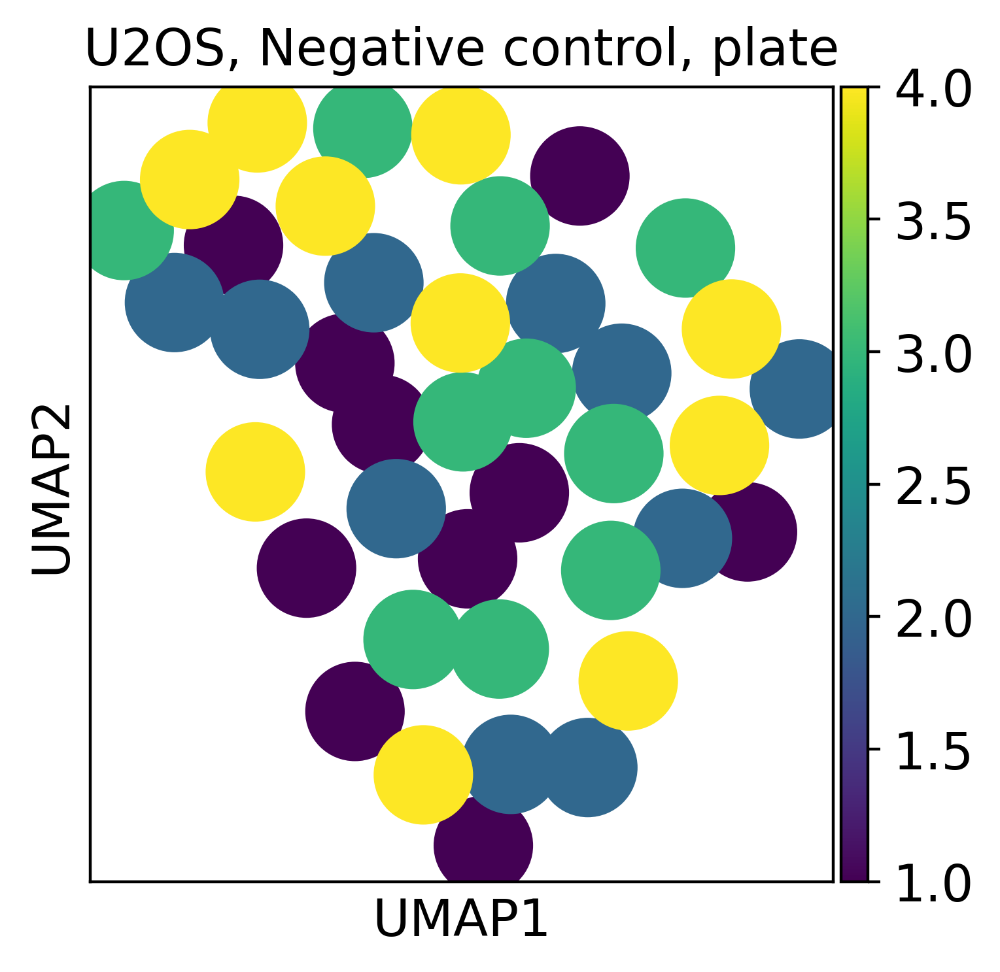

In [32]:
#positive control siRNA from above:
sc.pl.umap(poscontrol_sirna, color=["plate"], title = ["RPE, Positive control siRNA, plate"])
#negative control:
#RPE
sc.pl.umap(negcontrol_rpe, color=["plate"], title = ["RPE, Negative control,plate"])
#HUVEC
sc.pl.umap(negcontrol_huvec, color=["plate"], title = ["HUVEC, Negative control, plate" ])
#HEPG2
sc.pl.umap(negcontrol_hepg2, color=["plate"], title = ["HEPG2, Negative control, plate"])
#U2OS
sc.pl.umap(negcontrol_u2os, color=["plate"], title = ["U2OS, Negative control, plate"])

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


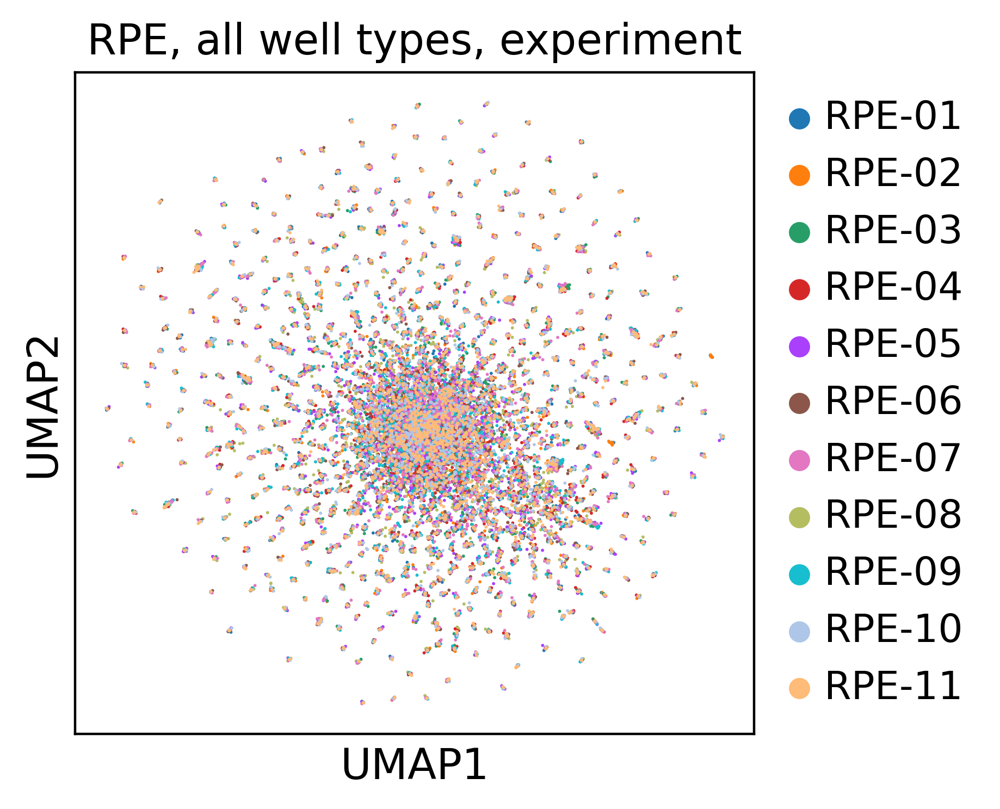

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


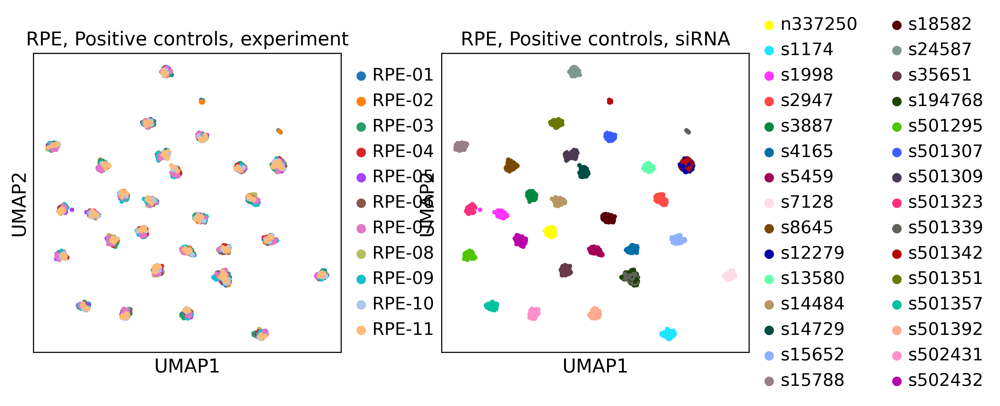

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


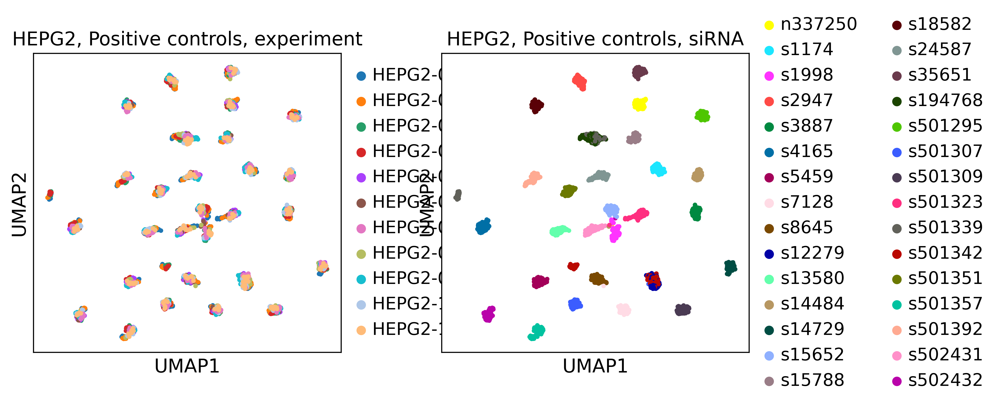

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


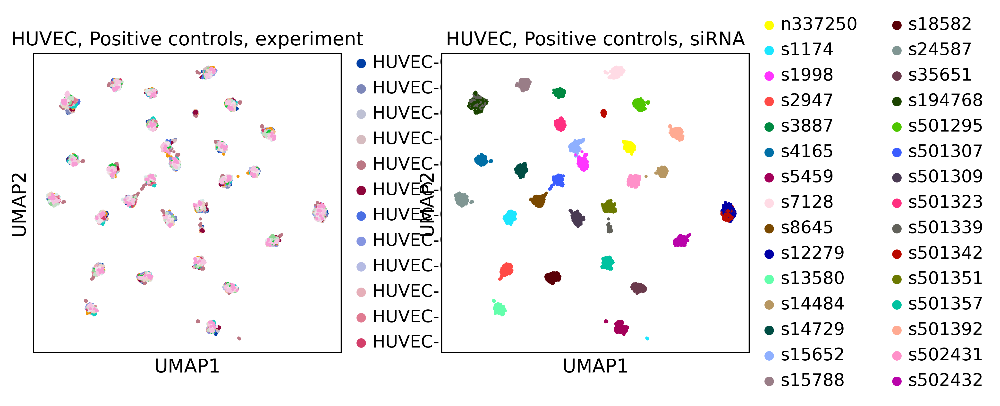

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


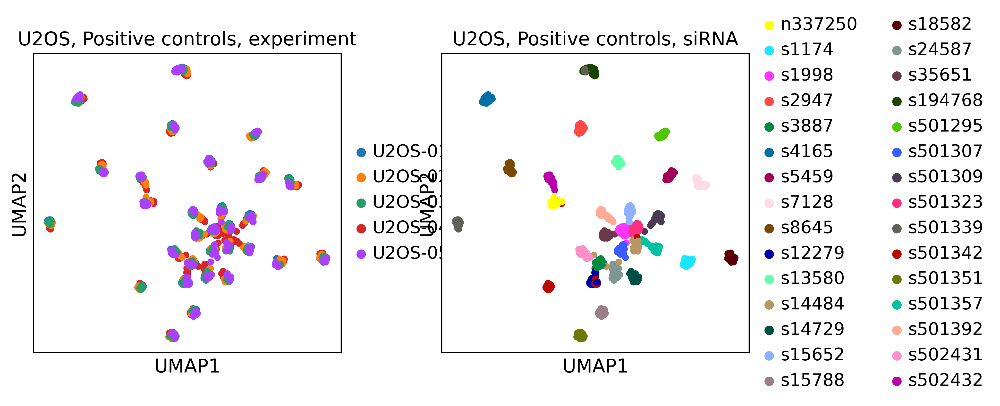

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


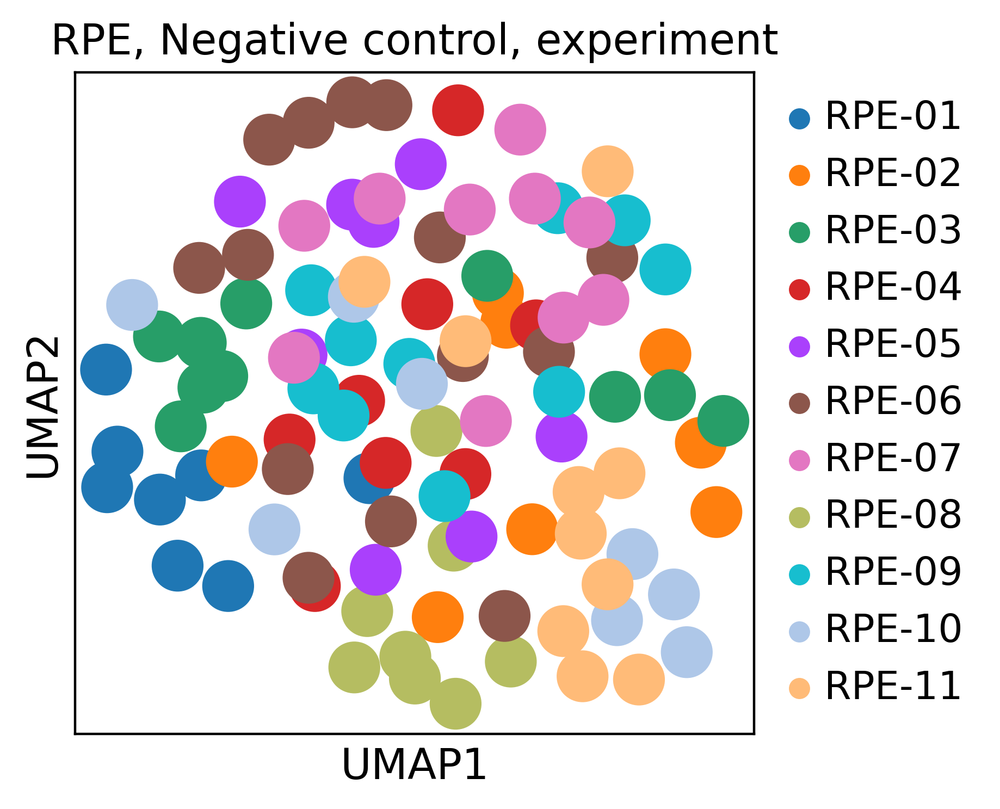

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


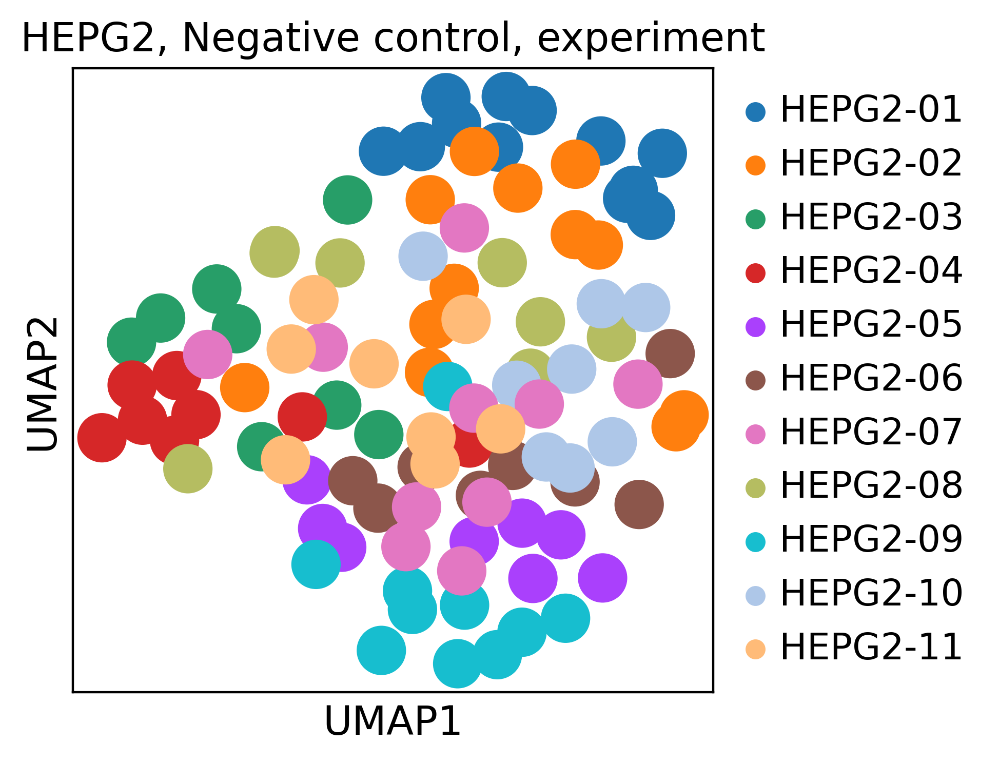

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


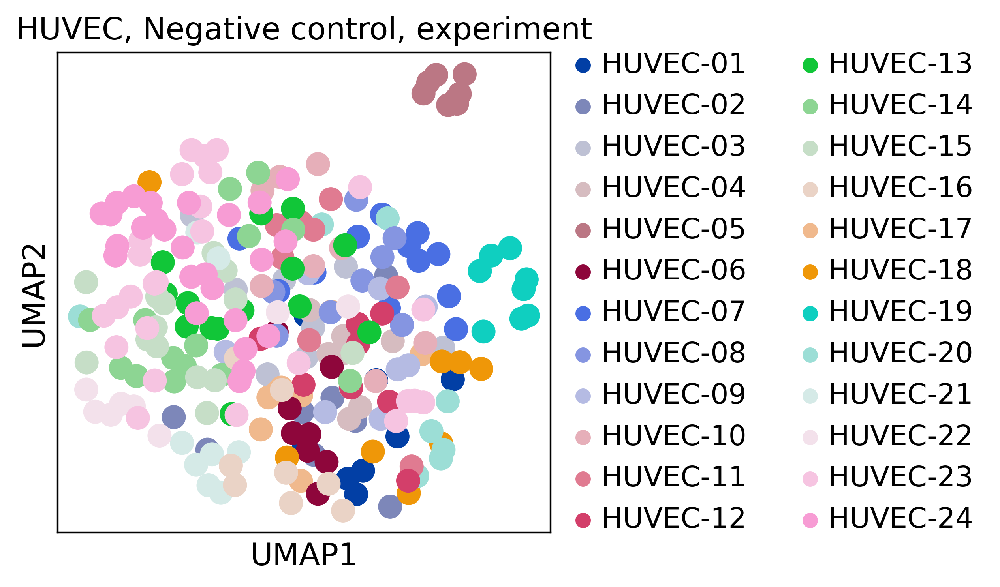

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


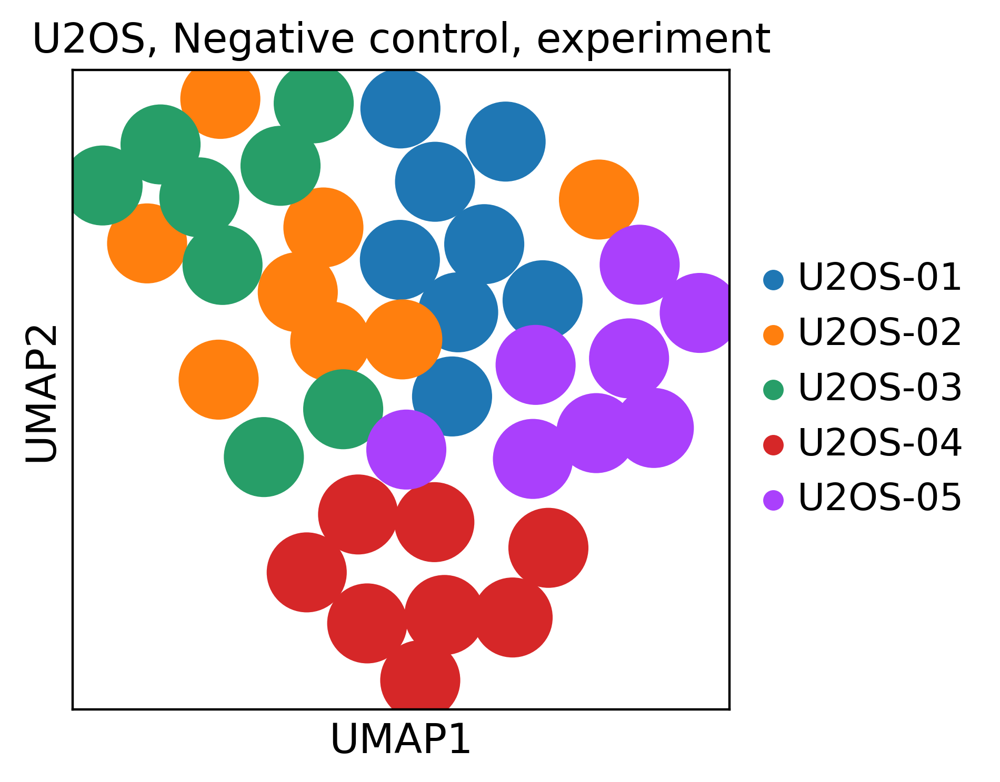

In [33]:
# all well types
adata_rpe = adata[adata.obs["cell_type"] == "RPE"]
sc.pp.neighbors(adata_rpe, n_neighbors=15, use_rep = "X")
sc.tl.umap(adata_rpe)
sc.pl.umap(adata_rpe, color=["experiment"], title = "RPE, all well types, experiment")
#positive controls:
#RPE
poscontrols_rpe = poscontrols[poscontrols.obs["cell_type"] == "RPE"]
sc.pp.neighbors(poscontrols_rpe, n_neighbors=15, use_rep = "X")
sc.tl.umap(poscontrols_rpe)
sc.pl.umap(poscontrols_rpe, color=["experiment", "sirna"], title = ["RPE, Positive controls, experiment", "RPE, Positive controls, siRNA"])
#HEPG2
poscontrols_hepg2 = poscontrols[poscontrols.obs["cell_type"] == "HEPG2"]
sc.pp.neighbors(poscontrols_hepg2, n_neighbors=15, use_rep = "X")
sc.tl.umap(poscontrols_hepg2)
sc.pl.umap(poscontrols_hepg2, color=["experiment", "sirna"], title = ["HEPG2, Positive controls, experiment", "HEPG2, Positive controls, siRNA"])
#HUVEC
poscontrols_huvec = poscontrols[poscontrols.obs["cell_type"] == "HUVEC"]
sc.pp.neighbors(poscontrols_huvec, n_neighbors=15, use_rep = "X")
sc.tl.umap(poscontrols_huvec)
sc.pl.umap(poscontrols_huvec, color=["experiment", "sirna"], title = ["HUVEC, Positive controls, experiment", "HUVEC, Positive controls, siRNA"])
#U2OS
poscontrols_u2os = poscontrols[poscontrols.obs["cell_type"] == "U2OS"]
sc.pp.neighbors(poscontrols_u2os, n_neighbors=15, use_rep = "X")
sc.tl.umap(poscontrols_u2os)
sc.pl.umap(poscontrols_u2os, color=["experiment", "sirna"], title = ["U2OS, Positive controls, experiment", "U2OS, Positive controls, siRNA"])

#negative controls:
sc.pl.umap(negcontrol_rpe, color=["experiment"], title = ["RPE, Negative control, experiment"])
sc.pl.umap(negcontrol_hepg2, color=["experiment"], title = ["HEPG2, Negative control, experiment"])
sc.pl.umap(negcontrol_huvec, color=["experiment"], title = ["HUVEC, Negative control, experiment"])
sc.pl.umap(negcontrol_u2os, color=["experiment"], title = ["U2OS, Negative control, experiment"])

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


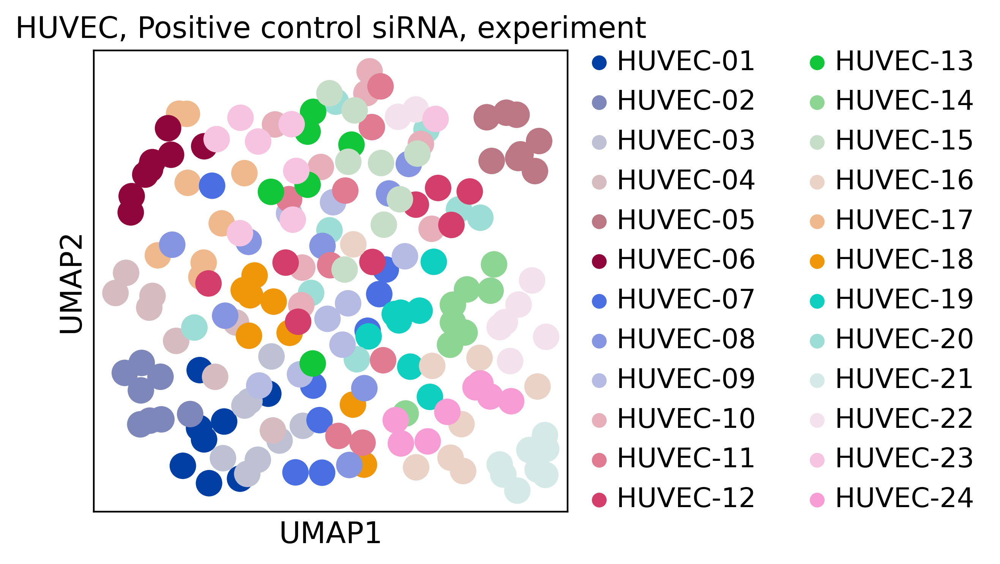

In [34]:
poscontrol_sirna = adata[(adata.obs["sirna"] == "s502431")  & (adata.obs["cell_type"] == "HUVEC")]
sc.pp.neighbors(poscontrol_sirna, n_neighbors=15, use_rep = "X")
sc.tl.umap(poscontrol_sirna)
sc.pl.umap(poscontrol_sirna, color=["experiment"], title = ["HUVEC, Positive control siRNA, experiment"])